In [4]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import numpy as np
import matplotlib.pyplot as plt
import os
import gdown
from zipfile import ZipFile

from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation
from keras.optimizers import SGD

In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [2]:
DATASET_DIR = '/content/gdrive/MyDrive/data/midjourney_images'

try:
  os.makedirs(DATASET_DIR)

except:
  pass


In [5]:
dataset = keras.preprocessing.image_dataset_from_directory (
    DATASET_DIR,
    label_mode=None,
    image_size=(64, 64),
    batch_size=32,
    seed=999,
    validation_split=0.95, # Spliting the dataset 1:9 (training:validation) just to make it smaller!
    subset='training' # Taking the smaller 'validation' set.
)
dataset = dataset.map(lambda x: x / 255.0)

Found 22 files belonging to 1 classes.
Using 2 files for training.


In [6]:
import os
from PIL import Image

def extract_color_palette(image_path, num_colors):
    # Open the image
    image = Image.open(image_path)

    # Convert the image to the RGB color mode
    rgb_image = image.convert('RGB')

    # Get the color histogram of the image
    histogram = rgb_image.histogram()



implemented from https://pypi.org/project/color-extraction/

In [7]:
import os
from PIL import Image

def extract_color_palette(image_path, num_colors):
    # Open the image
    image = Image.open(image_path)

    # Convert the image to the RGB color mode
    rgb_image = image.convert('RGB')

    # Quantize the image to reduce colors and get the palette
    palette = rgb_image.quantize(colors=num_colors).getpalette()

    # Extract the RGB values from the palette
    color_palette = []
    for i in range(0, len(palette), 3):
        r, g, b = palette[i], palette[i+1], palette[i+2]
        color_palette.append((r, g, b))

    return color_palette

# Directory containing the images
DATASET_DIR = '/content/gdrive/MyDrive/data/midjourney_images'

# Number of colors in the palette
num_colors = 5

# Iterate over the images in the directory
for filename in os.listdir(DATASET_DIR):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(DATASET_DIR, filename)
        palette = extract_color_palette(image_path, num_colors)
        print(f'Image: {filename}, Palette: {palette}')

Image: opn.png, Palette: [(156, 154, 148), (106, 90, 106), (105, 53, 76), (59, 46, 62), (30, 34, 49), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 0), (0, 0, 

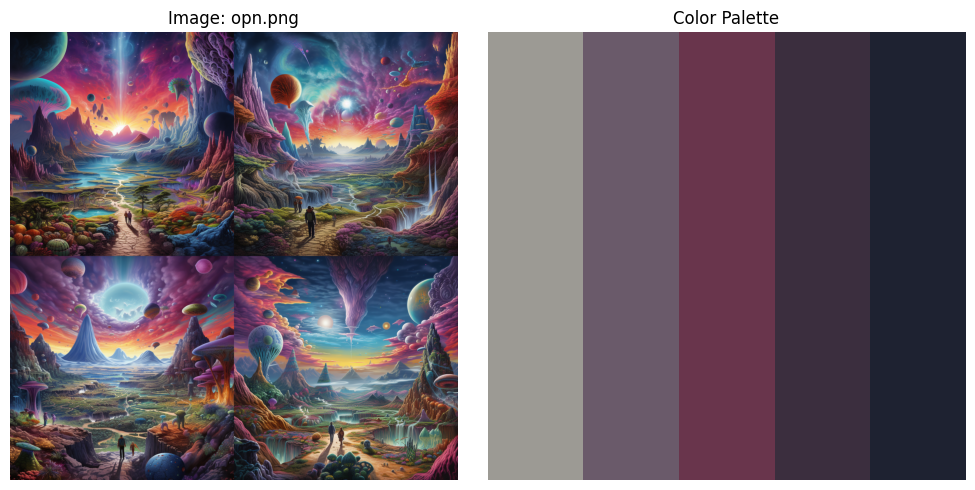

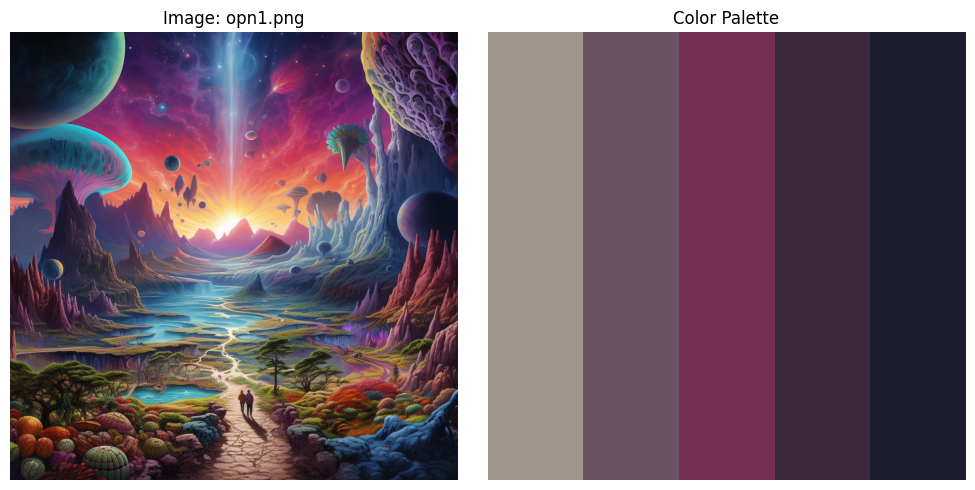

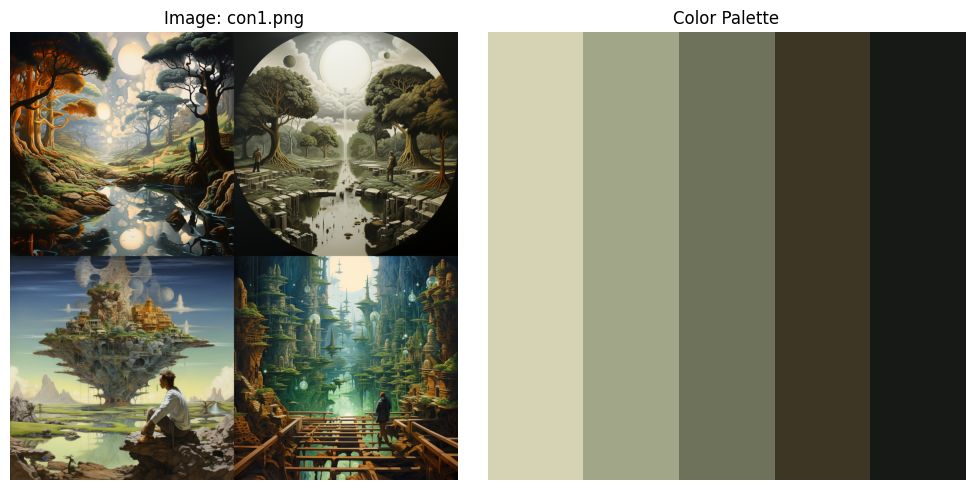

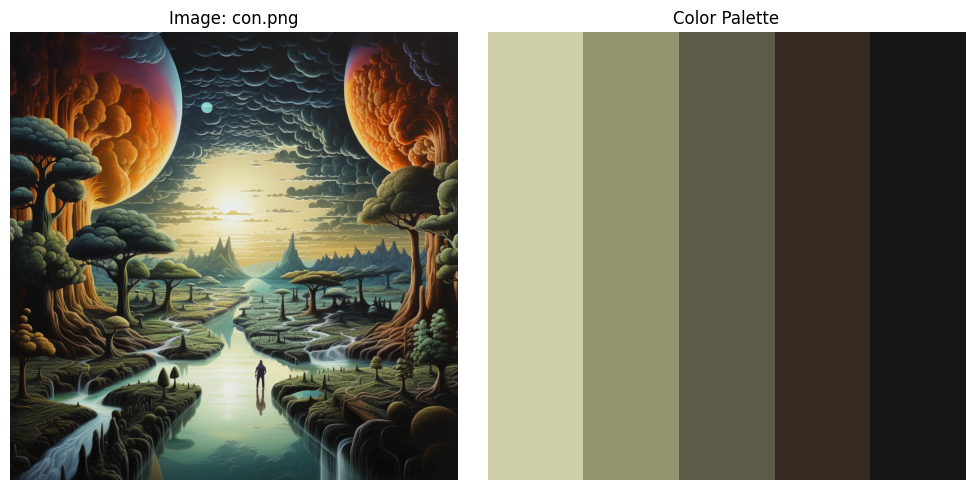

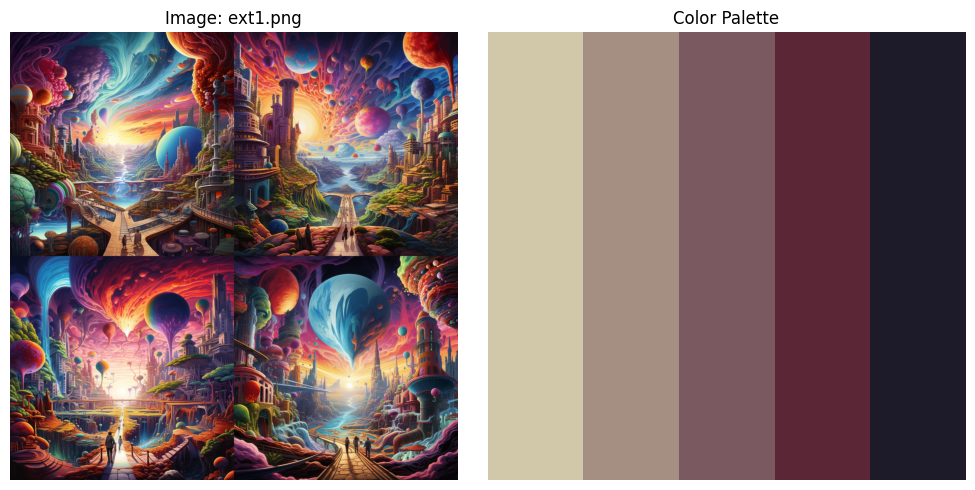

...

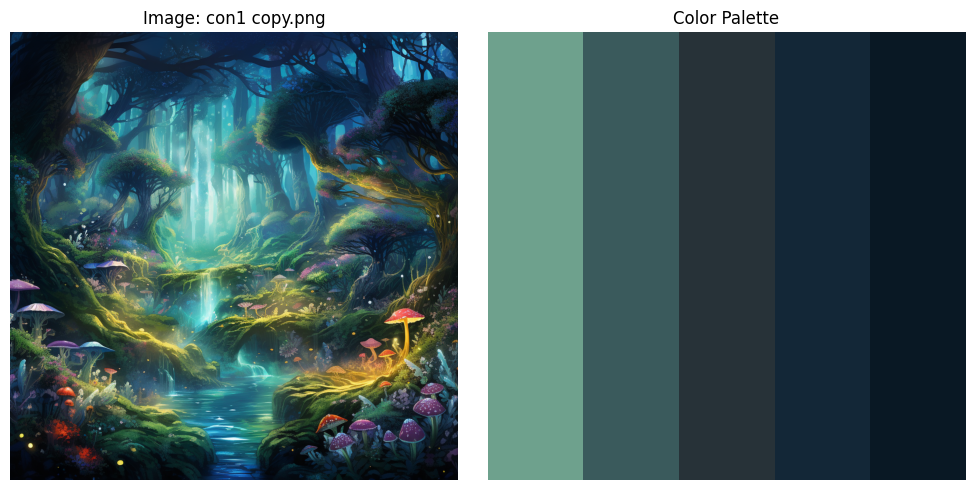

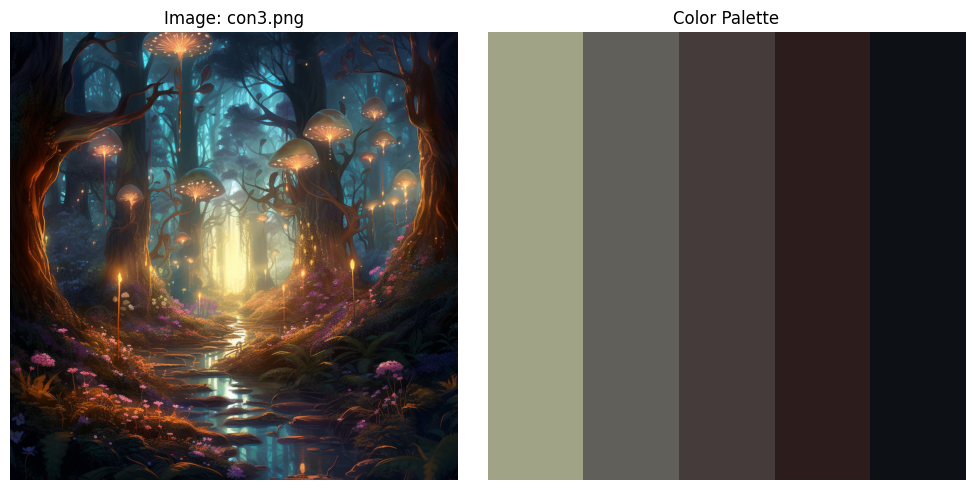

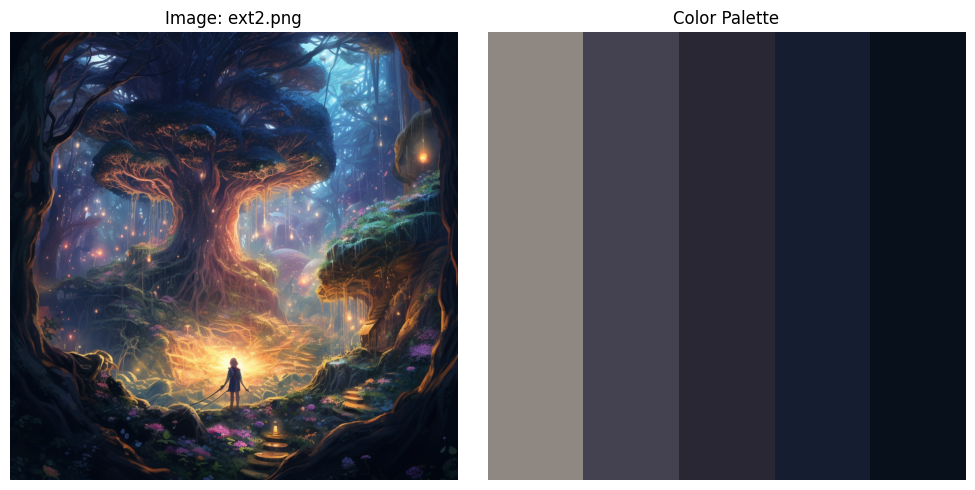

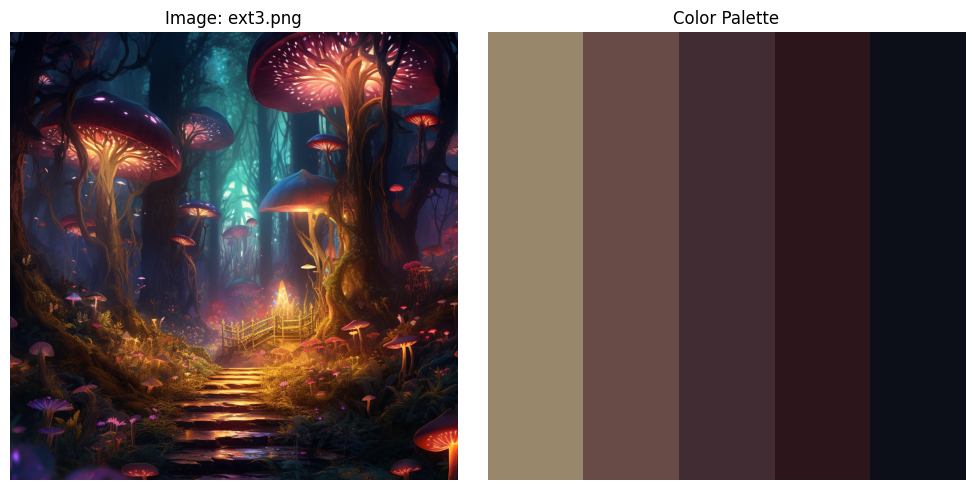

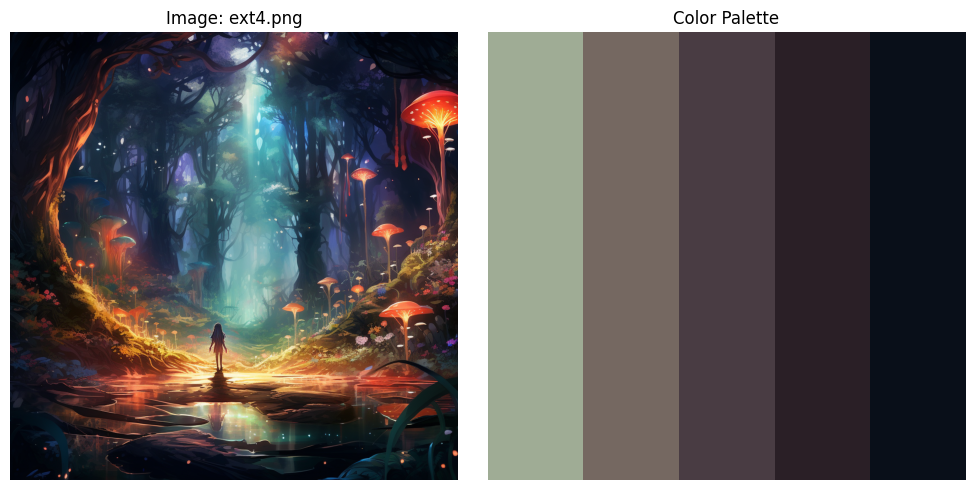

In [9]:
import os
from PIL import Image
import matplotlib.pyplot as plt

def extract_color_palette(image_path, num_colors):
    # Open the image
    image = Image.open(image_path)

    # Convert the image to the RGB color mode
    rgb_image = image.convert('RGB')

    # Quantize the image to reduce colors and get the palette
    palette = rgb_image.quantize(colors=num_colors).getpalette()

    # Extract the RGB values from the palette, excluding (0, 0, 0)
    color_palette = []
    for i in range(0, len(palette), 3):
        r, g, b = palette[i], palette[i+1], palette[i+2]
        if (r, g, b) != (0, 0, 0):
            color_palette.append((r, g, b))

    return color_palette

# Directory containing the images
DATASET_DIR = '/content/gdrive/MyDrive/data/midjourney_images'

# Number of colors in the palette
num_colors = 5

# Iterate over the images in the directory
for filename in os.listdir(DATASET_DIR):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(DATASET_DIR, filename)
        palette = extract_color_palette(image_path, num_colors)

        # Display the image
        image = Image.open(image_path)
        fig, axs = plt.subplots(1, 2, figsize=(10, 5))

        # Display the image
        axs[0].imshow(image)
        axs[0].set_title('Image: {}'.format(filename))
        axs[0].axis('off')

        # Display the color palette
        color_palette = [palette] * 10  # Repeating the palette for visual clarity
        axs[1].imshow(color_palette, aspect='auto')
        axs[1].set_title('Color Palette')
        axs[1].axis('off')

        # Adjust the layout
        plt.tight_layout()

        # Display the figure
        plt.show()


# Clustering colour pallet


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


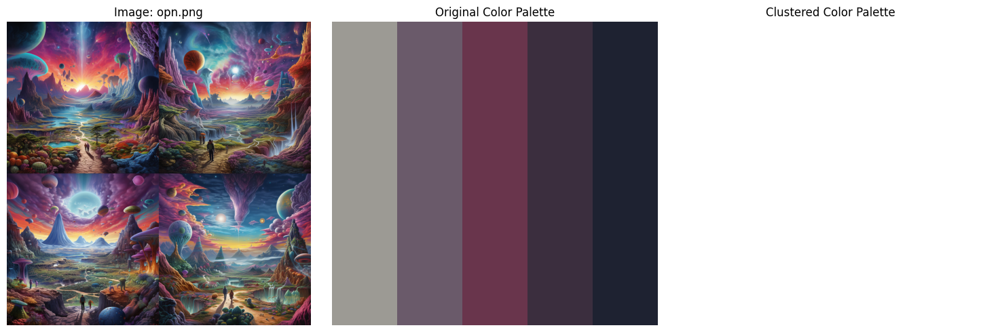

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


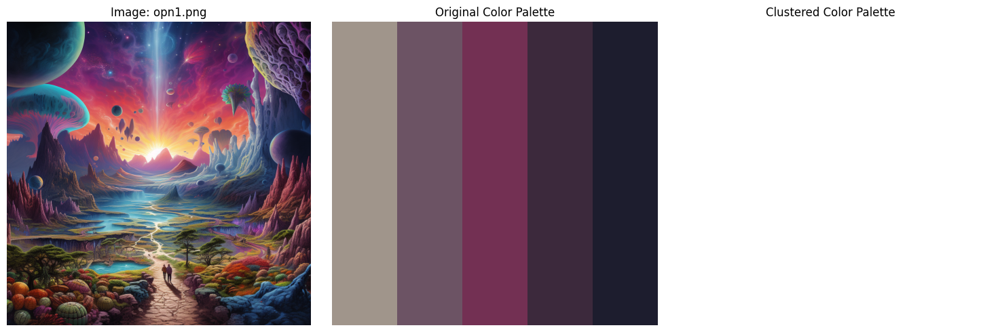

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


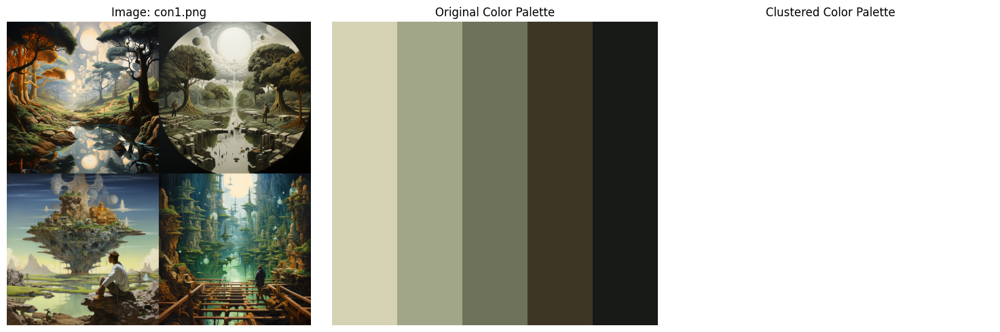

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


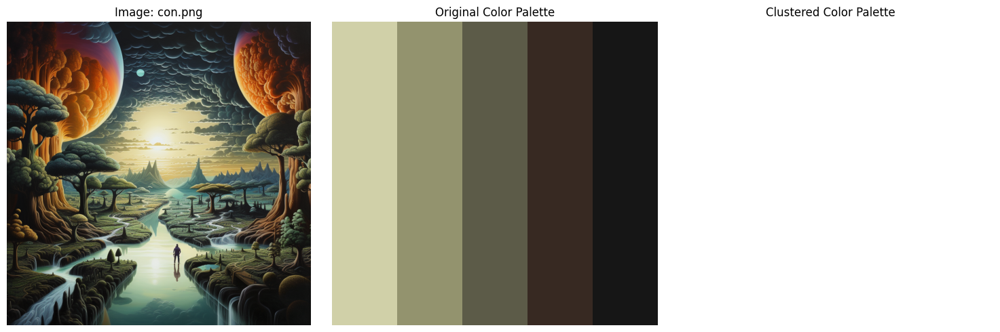

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


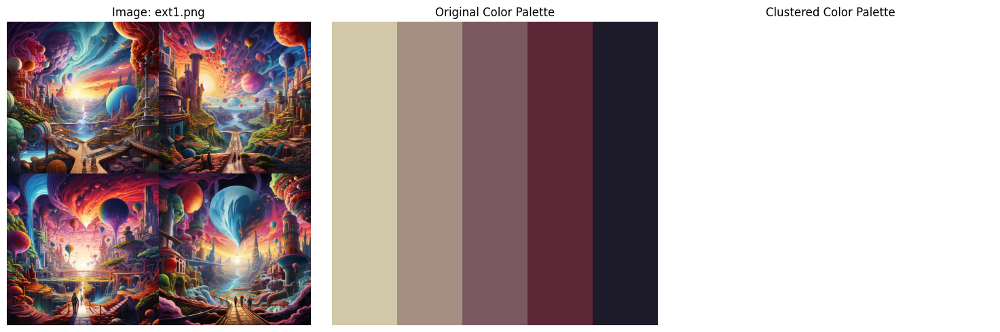

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


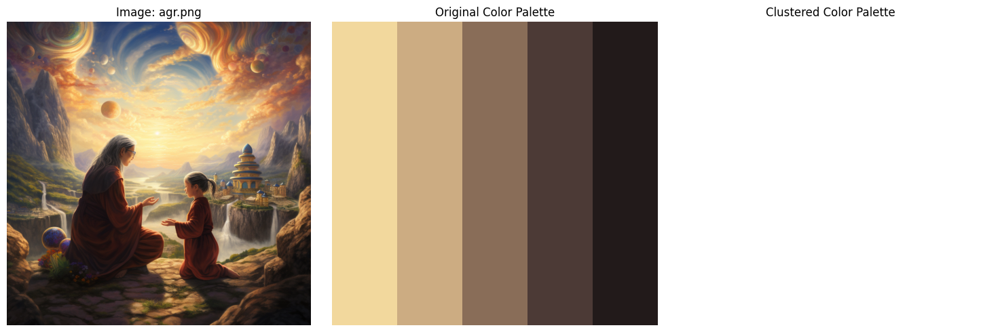

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


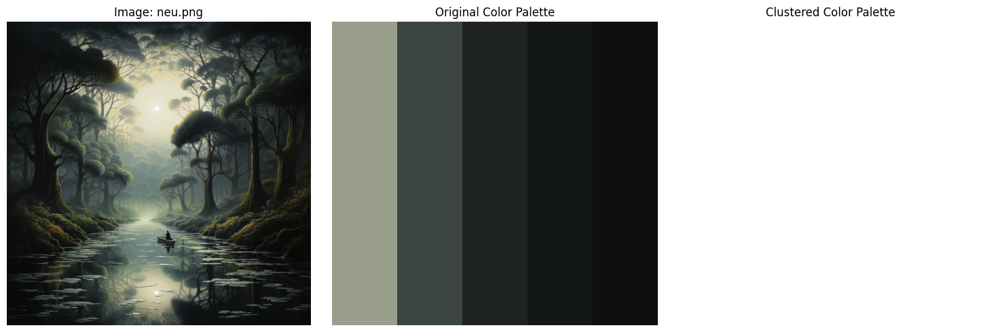

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


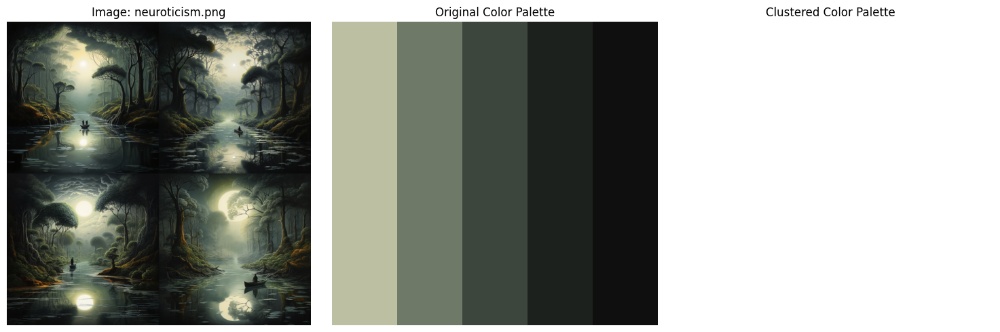

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


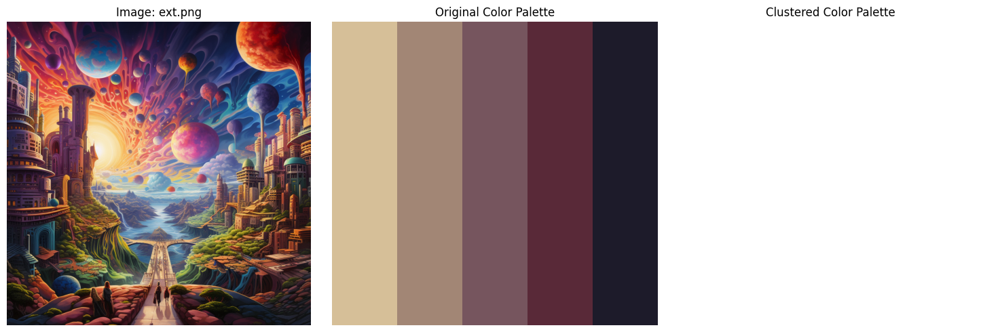

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


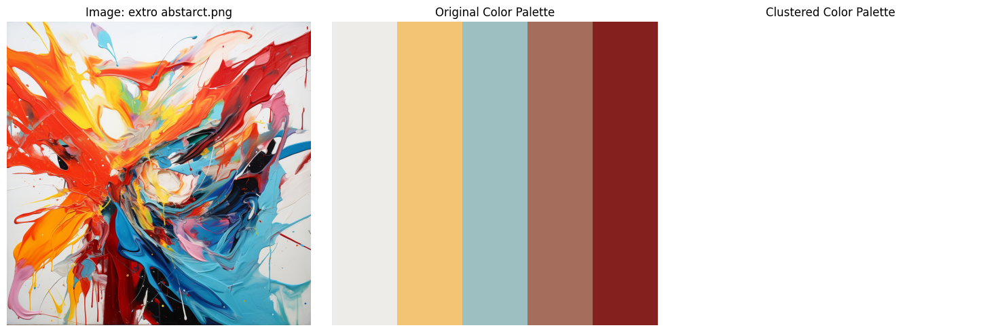

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


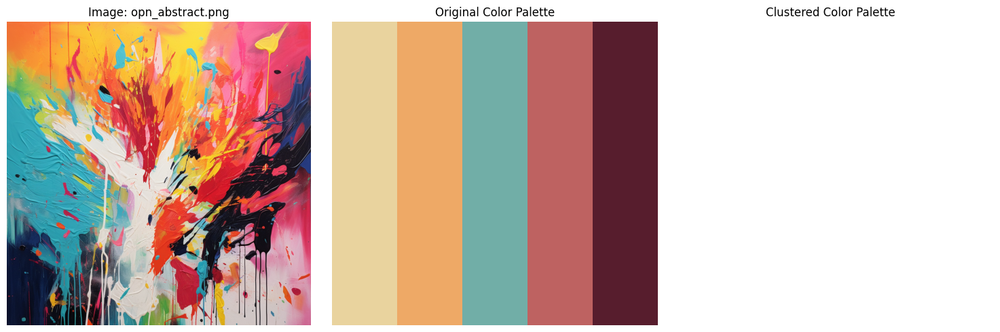

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


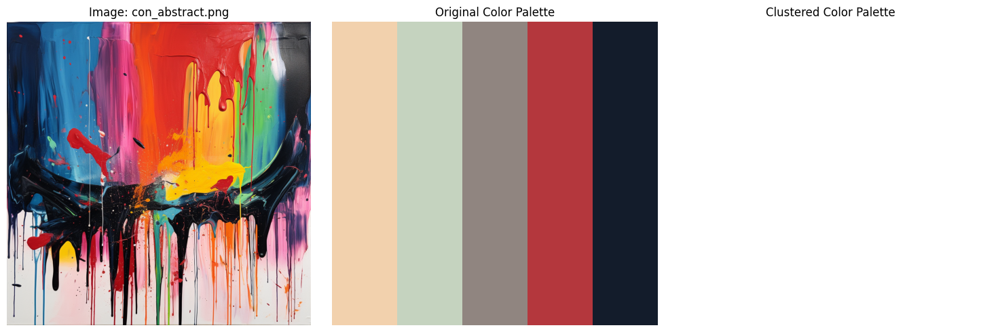

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


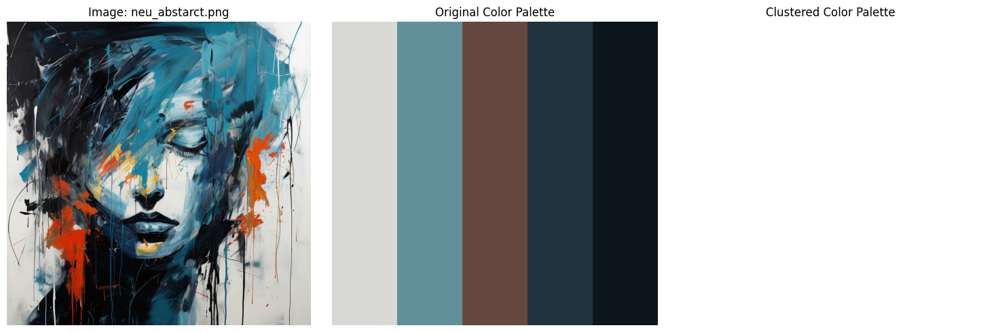

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


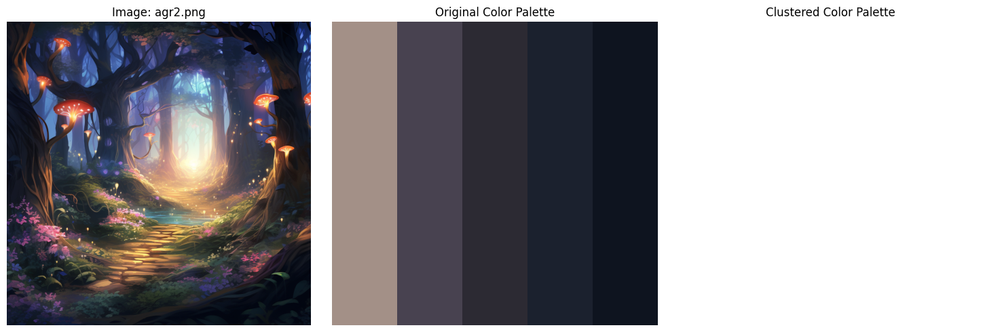

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


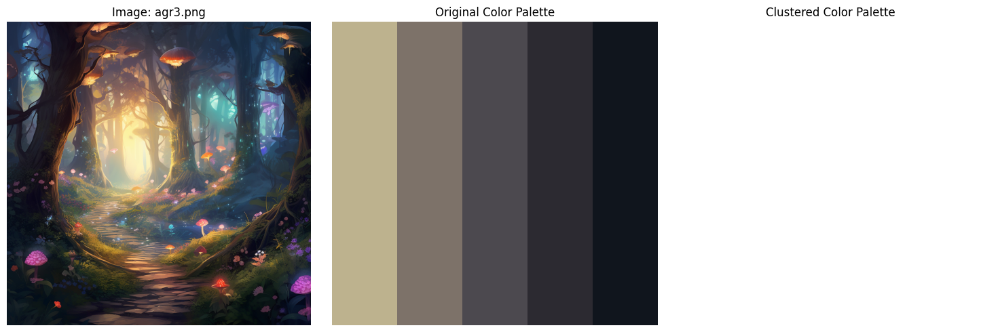

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


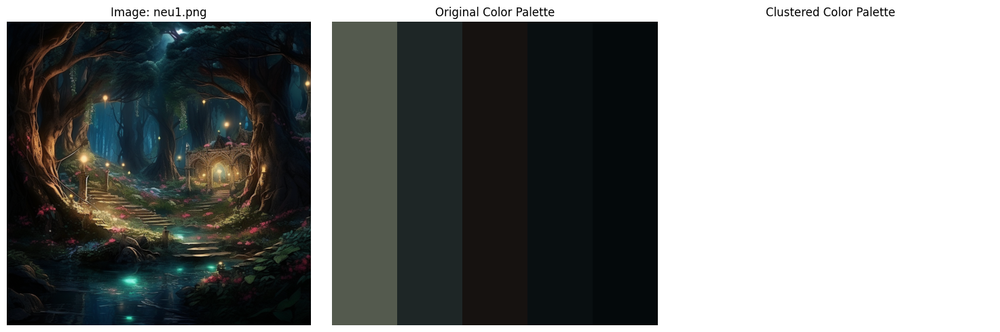

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


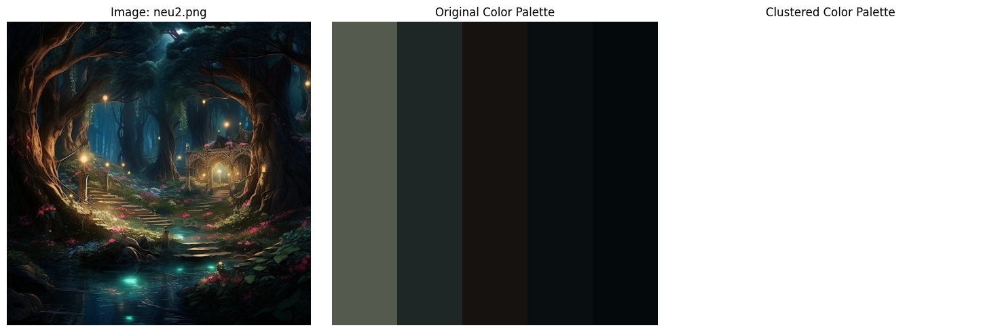

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


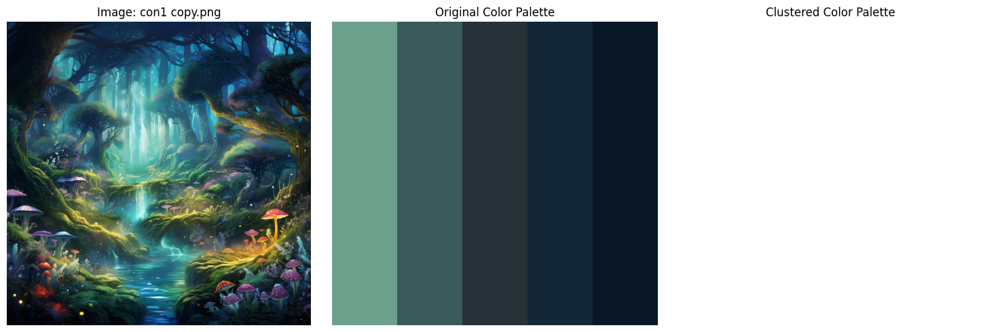

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


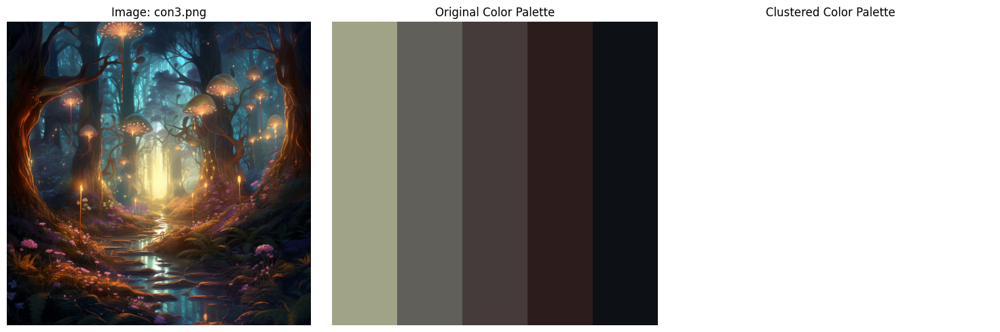

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


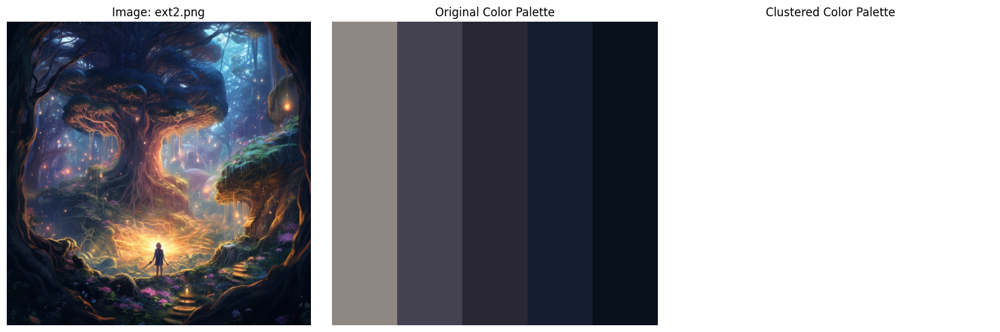

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


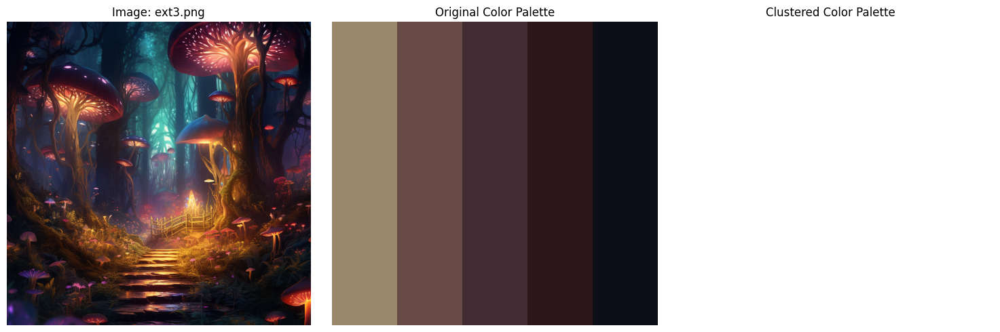

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


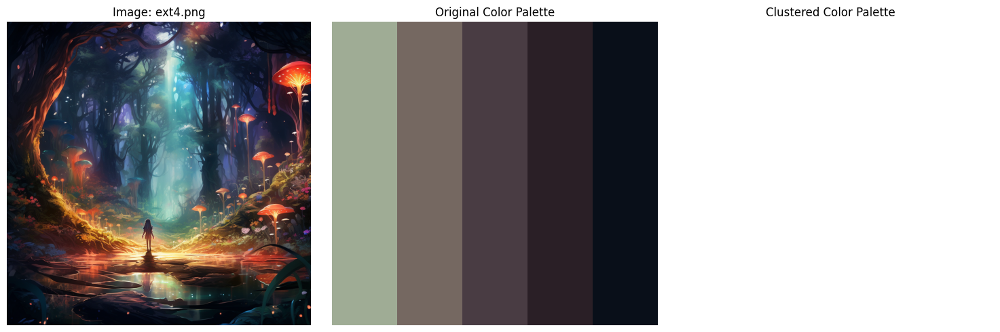

In [10]:
import os
from PIL import Image
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

def extract_color_palette(image_path, num_colors):
    # Open the image
    image = Image.open(image_path)

    # Convert the image to the RGB color mode
    rgb_image = image.convert('RGB')

    # Quantize the image to reduce colors and get the palette
    palette = rgb_image.quantize(colors=num_colors).getpalette()

    # Extract the RGB values from the palette, excluding (0, 0, 0)
    color_palette = []
    for i in range(0, len(palette), 3):
        r, g, b = palette[i], palette[i+1], palette[i+2]
        if (r, g, b) != (0, 0, 0):
            color_palette.append((r, g, b))

    return color_palette

# Directory containing the images
DATASET_DIR = '/content/gdrive/MyDrive/data/midjourney_images'

# Number of colors in the palette
num_colors = 5

# Number of clusters
num_clusters = 3

# Iterate over the images in the directory
for filename in os.listdir(DATASET_DIR):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(DATASET_DIR, filename)
        palette = extract_color_palette(image_path, num_colors)

        # Perform k-means clustering
        kmeans = KMeans(n_clusters=num_clusters)
        kmeans.fit(palette)
        cluster_labels = kmeans.labels_
        cluster_centers = kmeans.cluster_centers_

        # Display the image
        image = Image.open(image_path)
        fig, axs = plt.subplots(1, 3, figsize=(15, 5))

        # Display the image
        axs[0].imshow(image)
        axs[0].set_title('Image: {}'.format(filename))
        axs[0].axis('off')

        # Display the original color palette
        color_palette = [palette] * 10  # Repeating the palette for visual clarity
        axs[1].imshow(color_palette, aspect='auto')
        axs[1].set_title('Original Color Palette')
        axs[1].axis('off')

        # Display the clustered color palette
        clustered_palette = [cluster_centers[label] for label in cluster_labels]
        axs[2].imshow([clustered_palette], aspect='auto')
        axs[2].set_title('Clustered Color Palette')
        axs[2].axis('off')

        # Adjust the layout
        plt.tight_layout()

        # Display the figure
        plt.show()

*grouping similar colour pallet based on rgb value**

In [11]:
import os
from PIL import Image
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
import numpy as np

def extract_color_palette(image_path, num_colors):
    image = Image.open(image_path).convert('RGB')
    palette = image.quantize(colors=num_colors).getpalette()
    color_palette = [tuple(palette[i:i+3]) for i in range(0, len(palette), 3)]
    return [color for color in color_palette if color != (0, 0, 0)]

def calculate_distance(color1, color2):
    distance = np.sqrt((color2[0][0] - color1[0])**2 + (color2[0][1] - color1[1])**2 + (color2[0][2] - color1[2])**2)
    return distance

DATASET_DIR = '/content/gdrive/MyDrive/data/midjourney_images'
num_colors = 5
num_clusters = 3
color_palettes = []
cluster_categories = {}

for filename in os.listdir(DATASET_DIR):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(DATASET_DIR, filename)
        palette = extract_color_palette(image_path, num_colors)
        color_palettes.append(palette)

for i, palette in enumerate(color_palettes):
    found_category = False
    for category, palettes in cluster_categories.items():
        for existing_palette, _ in palettes:
            distances = [calculate_distance(color, existing_palette) for color in palette]
            avg_distance = sum(distances) / len(distances)
            if avg_distance < 50:  # Adjust the threshold as needed
                cluster_categories[category].append((palette, i))
                found_category = True
                break
        if found_category:
            break

    if not found_category:
        cluster_categories[len(cluster_categories) + 1] = [(palette, i)]

for category, palettes in cluster_categories.items():
    print('Category {}:'.format(category))
    for _, palette_index in palettes:
        print('- Image Index: {}'.format(palette_index))
    print()

Category 1:
- Image Index: 0

Category 2:
- Image Index: 1

Category 3:
- Image Index: 2

Category 4:
- Image Index: 3

Category 5:
- Image Index: 4

Category 6:
- Image Index: 5

Category 7:
- Image Index: 6

Category 8:
- Image Index: 7

Category 9:
- Image Index: 8

Category 10:
- Image Index: 9

Category 11:
- Image Index: 10

Category 12:
- Image Index: 11

Category 13:
- Image Index: 12

Category 14:
- Image Index: 13

Category 15:
- Image Index: 14

Category 16:
- Image Index: 15

Category 17:
- Image Index: 16

Category 18:
- Image Index: 17

Category 19:
- Image Index: 18

Category 20:
- Image Index: 19

Category 21:
- Image Index: 20

Category 22:
- Image Index: 21



In [ ]:
import os
from PIL import Image
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
import numpy as np

def extract_color_palette(image_path, num_colors):
    image = Image.open(image_path).convert('RGB')
    palette = image.quantize(colors=num_colors).getpalette()
    color_palette = [tuple(palette[i:i+3]) for i in range(0, len(palette), 3)]
    return [color for color in color_palette if color != (0, 0, 0)]

def calculate_distance(color1, color2):
    distance = np.sqrt((color2[0][0] - color1[0])**2 + (color2[0][1] - color1[1])**2 + (color2[0][2] - color1[2])**2)
    return distance

DATASET_DIR = '/content/gdrive/MyDrive/dataset_light/light_space'
num_colors = 5
num_clusters = 3
color_palettes = []
cluster_categories = {}

for filename in os.listdir(DATASET_DIR):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(DATASET_DIR, filename)
        palette = extract_color_palette(image_path, num_colors)
        color_palettes.append(palette)

for i, palette in enumerate(color_palettes):
    found_category = False
    for category, palettes in cluster_categories.items():
        for existing_palette, _ in palettes:
            distances = [calculate_distance(color, existing_palette) for color in palette]
            avg_distance = sum(distances) / len(distances)
            if avg_distance < 50:  # Adjust the threshold as needed
                cluster_categories[category].append((palette, i))
                found_category = True
                break
        if found_category:
            break

    if not found_category:
        cluster_categories[len(cluster_categories) + 1] = [(palette, i)]

for category, palettes in cluster_categories.items():
    print('Category {}:'.format(category))
    for _, palette_index in palettes:
        print('- Image Index: {}'.format(palette_index))
        image_path = os.path.join(DATASET_DIR, os.listdir(DATASET_DIR)[palette_index])
        image = Image.open(image_path)
        plt.imshow(image)
        plt.axis('off')
        plt.show()
    print()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


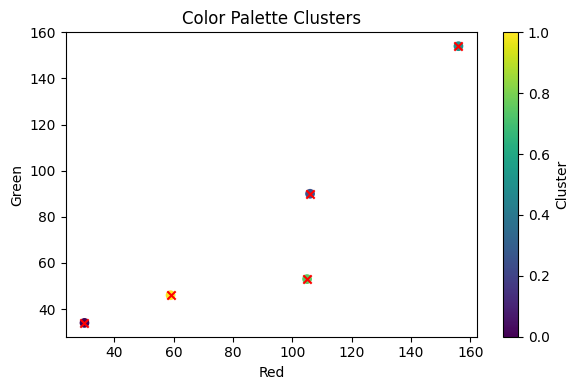

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


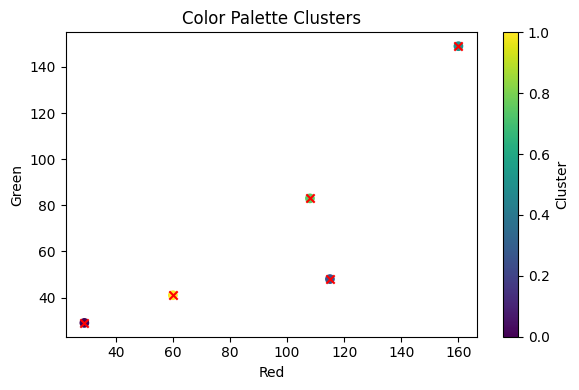

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


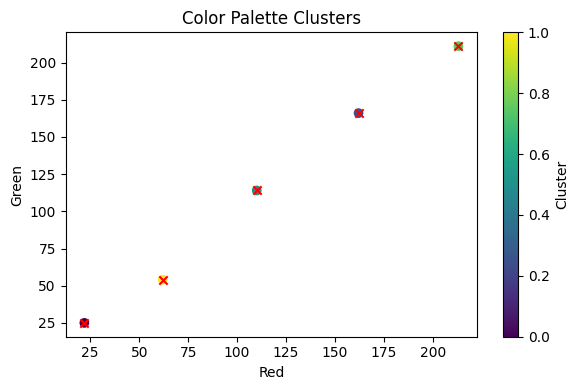

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


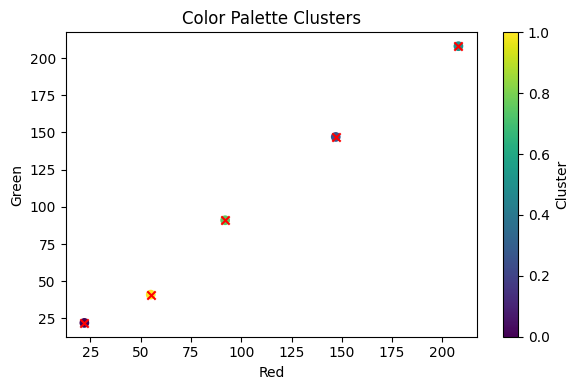

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


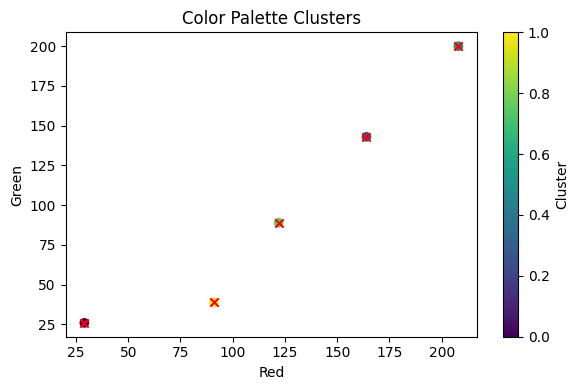

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


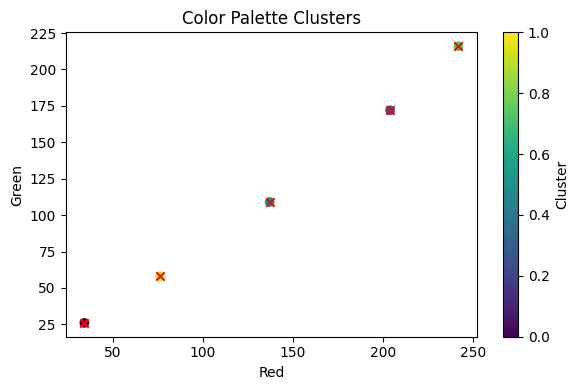

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


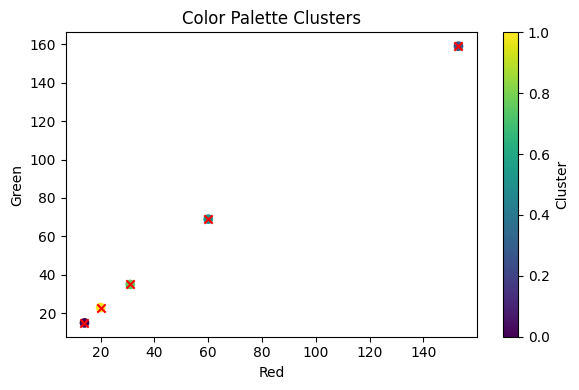

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


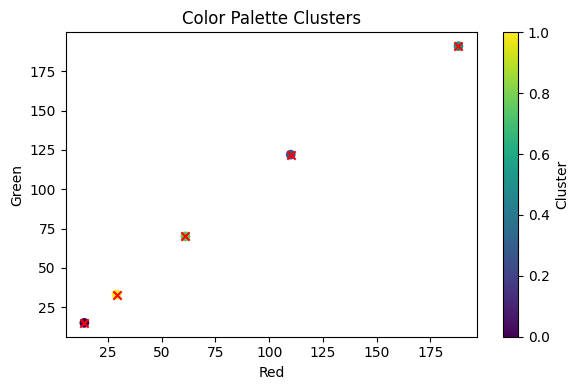

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


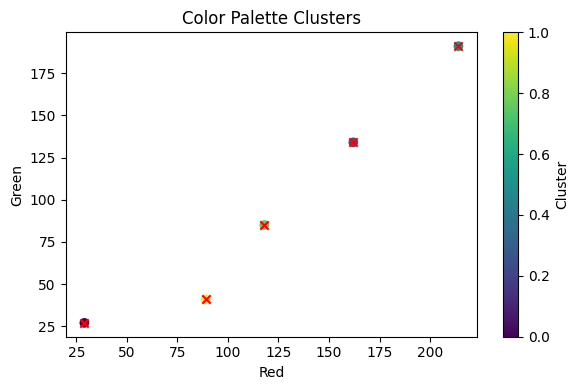

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


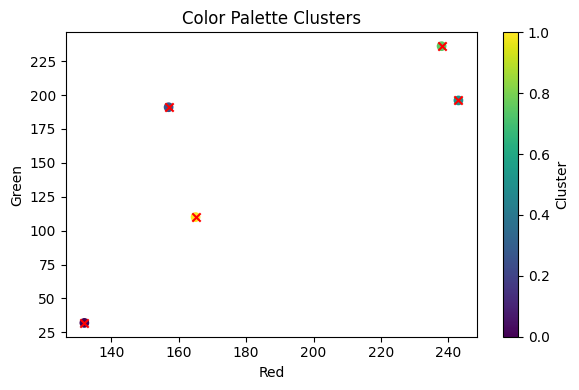

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


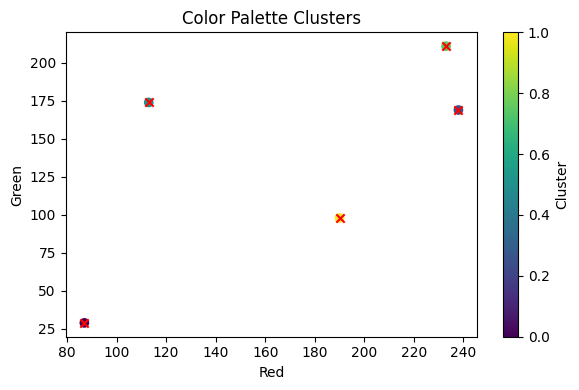

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


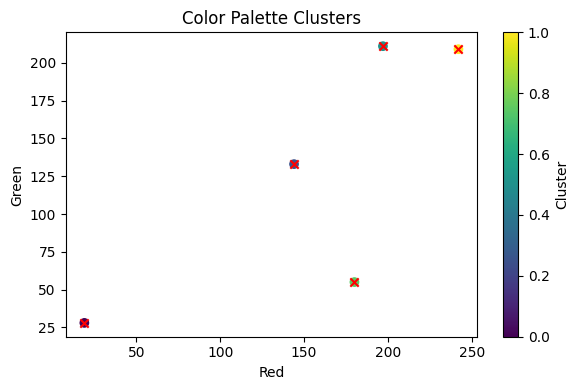

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


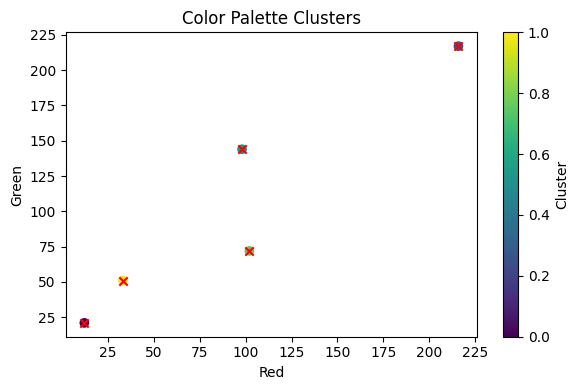

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


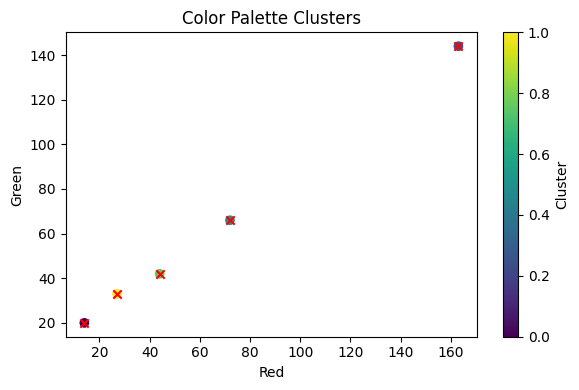

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


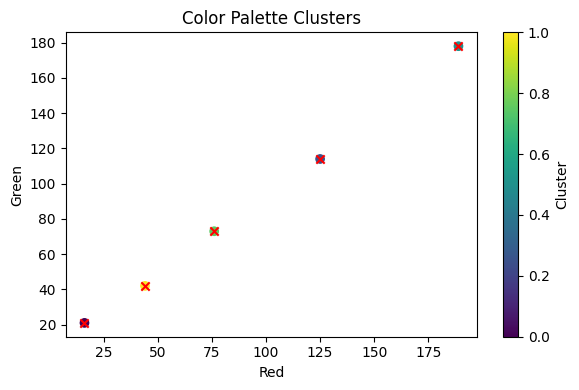

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


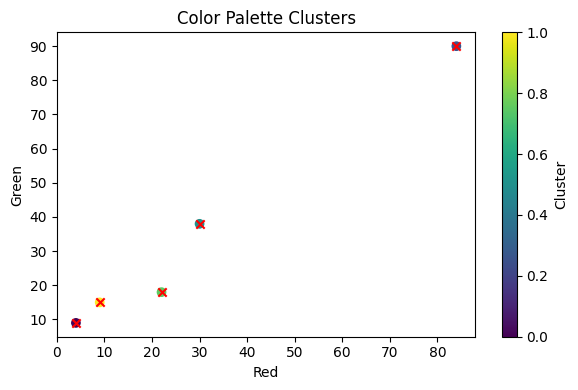

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


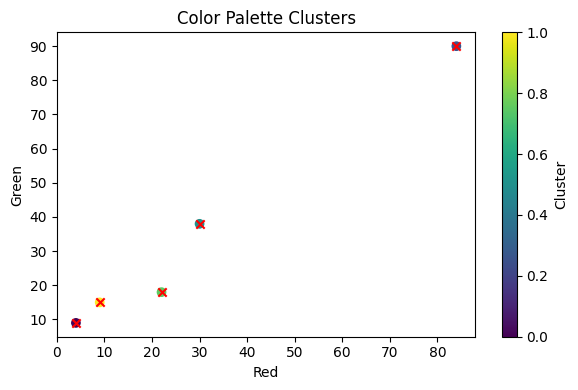

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


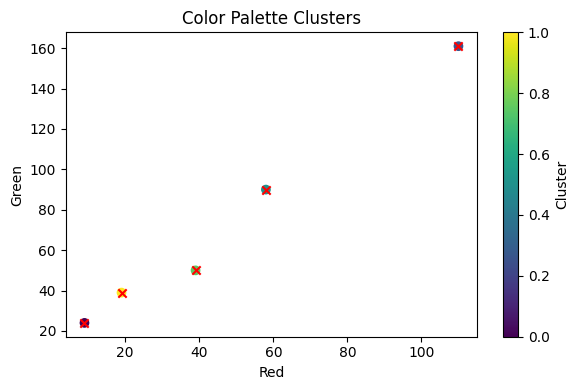

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


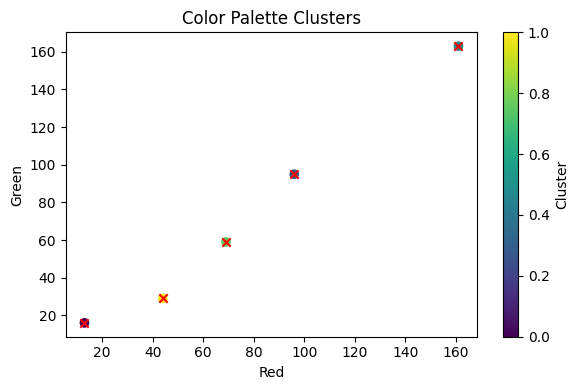

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


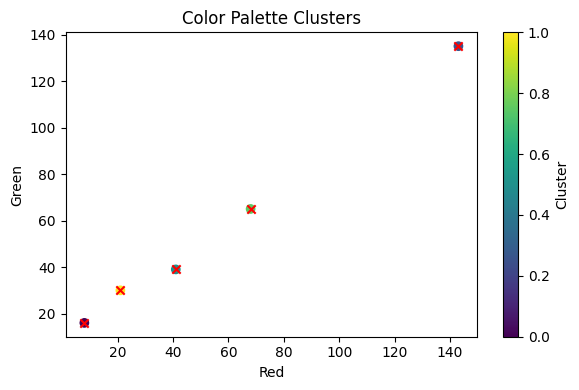

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


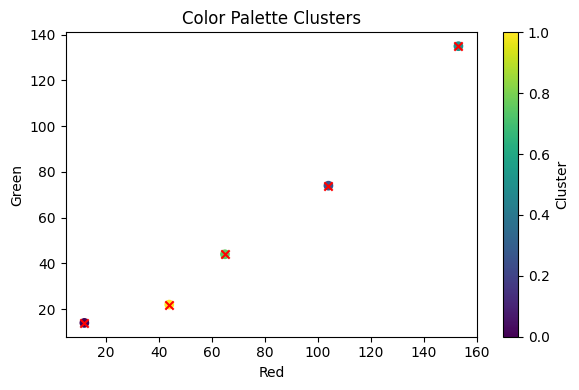

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


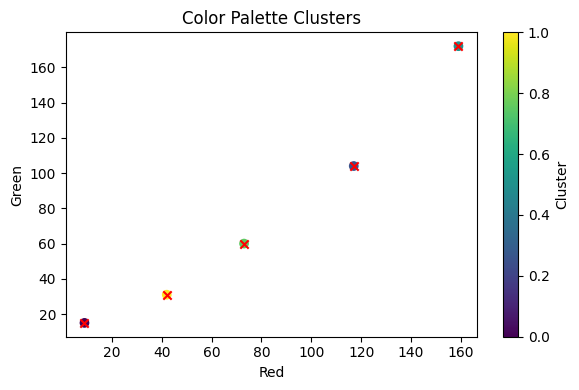

In [12]:
import os
from PIL import Image
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
import numpy as np

def extract_color_palette(image_path, num_colors):
    # Open the image
    image = Image.open(image_path)

    # Convert the image to the RGB color mode
    rgb_image = image.convert('RGB')

    # Quantize the image to reduce colors and get the palette
    palette = rgb_image.quantize(colors=num_colors).getpalette()

    # Extract the RGB values from the palette, excluding (0, 0, 0)
    color_palette = []
    for i in range(0, len(palette), 3):
        r, g, b = palette[i], palette[i+1], palette[i+2]
        if (r, g, b) != (0, 0, 0):
            color_palette.append((r, g, b))

    return color_palette

# Directory containing the images
DATASET_DIR = '/content/gdrive/MyDrive/data/midjourney_images'

# Number of colors in the palette
num_colors = 5

# Iterate over the images in the directory
for filename in os.listdir(DATASET_DIR):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        image_path = os.path.join(DATASET_DIR, filename)
        palette = extract_color_palette(image_path, num_colors)

        # Remove color (0, 0, 0) from the palette
        palette = [color for color in palette if color != (0, 0, 0)]

        # Check if the number of colors is greater than or equal to the number of clusters
        if len(palette) >= num_colors:
            # Perform clustering on the color palette
            kmeans = KMeans(n_clusters=num_colors, random_state=0).fit(palette)
            cluster_labels = kmeans.labels_
            cluster_centers = kmeans.cluster_centers_

            # Create scatter plot of color clusters
            plt.figure(figsize=(6, 4))
            plt.scatter([color[0] for color in palette], [color[1] for color in palette], c=cluster_labels)
            plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], c='red', marker='x')
            plt.title('Color Palette Clusters')
            plt.xlabel('Red')
            plt.ylabel('Green')
            plt.colorbar(label='Cluster')
            plt.tight_layout()
            plt.show()
        else:
            print(f'Not enough colors in the palette for clustering in {filename}.')